<a href="https://colab.research.google.com/github/Tahalachabc/TP_CM_network/blob/main/CM_network_TPS.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# EXERCICE 1

In [ ]:
# obligatoire pour exercice 7.6
!pip install --upgrade numpy gensim
!pip install node2vec --force-reinstall --no-cache-dir

  Using cached numpy-2.2.4-cp311-cp311-manylinux_2_17_x86_64.manylinux2014_x86_64.whl.metadata (62 kB)
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 61.0/61.0 kB 147.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 57.7/57.7 kB 178.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 60.6/60.6 kB 172.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 26.7/26.7 MB 68.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 301.8/301.8 kB 221.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.7/1.7 MB 41.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 18.3/18.3 MB 187.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 78.5/78.5 kB 175.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 38.6/38.6 MB 177.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 61.7/61.7 kB 175.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 83.2/83.2 kB 191.7 MB/s eta 0:00:00
  Attempting 

In [ ]:
import json
import pandas as pd

# Fonction pour charger un fichier JSONL
def load_jsonl(json_file):
    data = []
    with open(json_file, "r", encoding="utf-8") as f:
        for line in f:
            try:
                data.append(json.loads(line.strip()))  # Charger chaque ligne comme un JSON
            except json.JSONDecodeError as e:
                print(f"Erreur de décodage JSON sur la ligne : {line[:100]}")
                print(e)
    return data

# Chemin du fichier JSONL (à adapter)
json_file = "/content/dblp-ref-0.json"

# Charger les données
data = load_jsonl(json_file)

# Afficher le nombre d'articles chargés
print(f"Nombre d'articles chargés : {len(data)}")

# Convertir en DataFrame pandas
df = pd.DataFrame(data)

# Vérifier les colonnes disponibles
print(df.columns)

# Afficher un échantillon
print(df.head())


Nombre d'articles chargés : 1000000
Index(['abstract', 'authors', 'n_citation', 'references', 'title', 'venue',
       'year', 'id'],
      dtype='object')
                                            abstract  \
0  The purpose of this study is to develop a lear...   
1  This paper describes the design and implementa...   
2  This article applied GARCH model instead AR or...   
3                                                NaN   
4                                                NaN   

                                             authors  n_citation  \
0  [Makoto Satoh, Ryo Muramatsu, Mizue Kayama, Ka...           0   
1                        [Gareth Beale, Graeme Earl]          50   
2  [Altaf Hossain, Faisal Zaman, Mohammed Nasser,...          50   
3  [Jea-Bum Park, Byungmok Kim, Jian Shen, Sun-Yo...           0   
4                [Giovanna Guerrini, Isabella Merlo]           2   

                                          references  \
0  [51c7e02e-f5ed-431a-8cf5-f761f266d4be, 

In [ ]:
# Afficher les valeurs manquantes par colonne
print("Valeurs manquantes par colonne :")
print(df.isnull().sum())

Valeurs manquantes par colonne :
abstract      246354
authors            0
n_citation         0
references    138520
title              0
venue              0
year               0
id                 0
dtype: int64


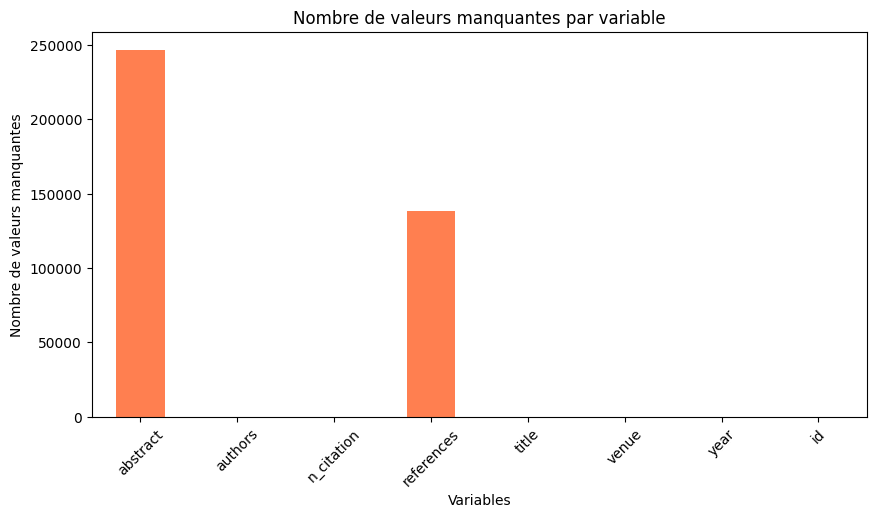

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Affichage des valeurs manquantes sous forme de barres
plt.figure(figsize=(10, 5))
df.isnull().sum().plot(kind='bar', color='coral')
plt.title("Nombre de valeurs manquantes par variable")
plt.xlabel("Variables")
plt.ylabel("Nombre de valeurs manquantes")
plt.xticks(rotation=45)
plt.show()


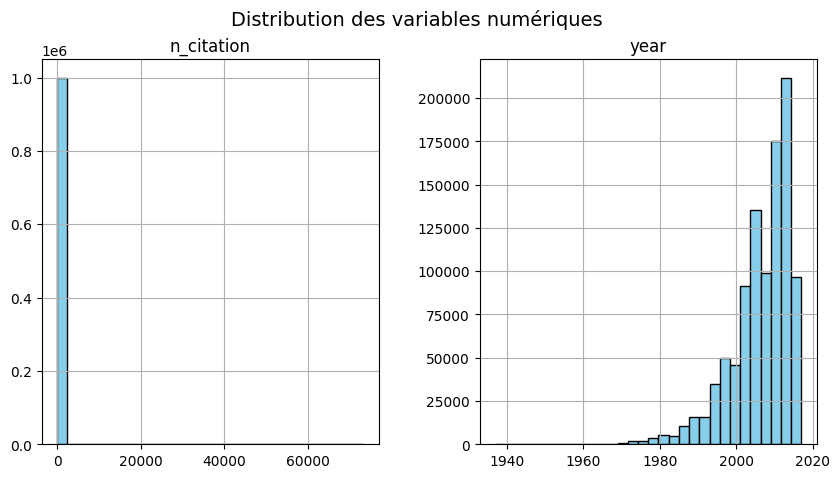

In [ ]:
# Sélectionner les colonnes numériques
numeric_cols = df.select_dtypes(include=['number']).columns

# Tracer les histogrammes des variables numériques
df[numeric_cols].hist(figsize=(10, 5), bins=30, color='skyblue', edgecolor='black')
plt.suptitle("Distribution des variables numériques", fontsize=14)
plt.show()


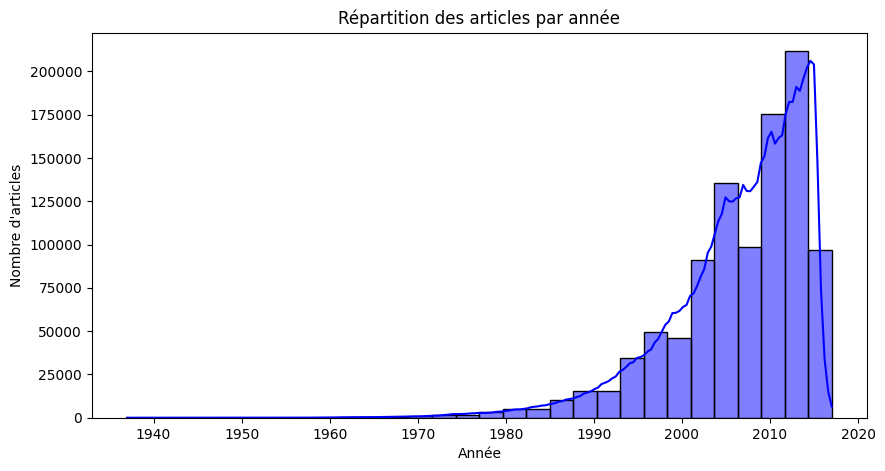

In [ ]:
plt.figure(figsize=(10, 5))
sns.histplot(df['year'], bins=30, kde=True, color='blue')
plt.title("Répartition des articles par année")
plt.xlabel("Année")
plt.ylabel("Nombre d'articles")
plt.show()


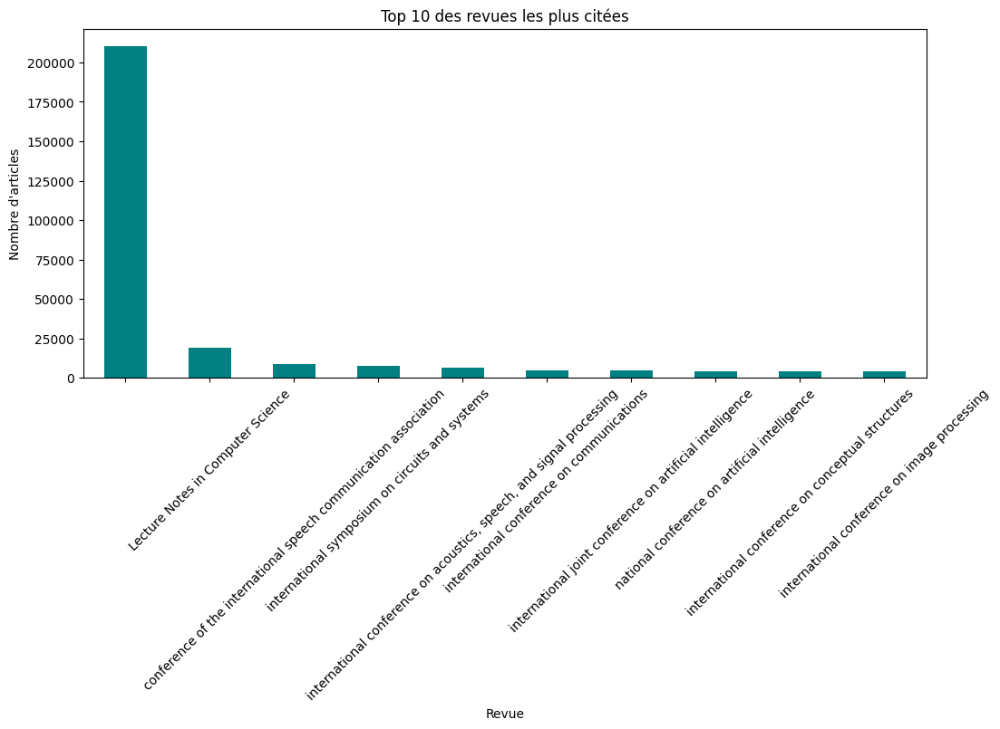

In [ ]:
plt.figure(figsize=(12, 5))
df['venue'].value_counts().nlargest(10).plot(kind='bar', color='teal')
plt.title("Top 10 des revues les plus citées")
plt.xlabel("Revue")
plt.ylabel("Nombre d'articles")
plt.xticks(rotation=45)
plt.show()


<ipython-input-8-43020118a13d>:15: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x="Catégorie", y="Pourcentage", data=missing_df, palette="coolwarm")


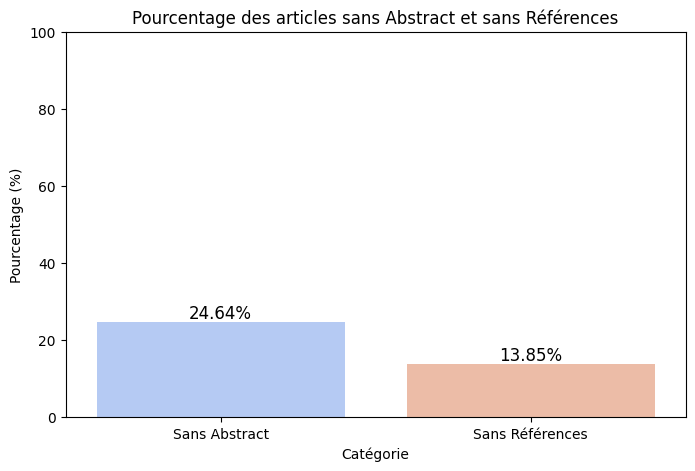

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Calculer le pourcentage des articles sans abstract et sans références
missing_data = {
    "Sans Abstract": df['abstract'].isnull().mean() * 100,
    "Sans Références": df['references'].isnull().mean() * 100
}

# Création du DataFrame pour le plotting
missing_df = pd.DataFrame(list(missing_data.items()), columns=["Catégorie", "Pourcentage"])

# Tracer le graphique
plt.figure(figsize=(8, 5))
sns.barplot(x="Catégorie", y="Pourcentage", data=missing_df, palette="coolwarm")

# Ajouter les valeurs sur les barres
for index, row in missing_df.iterrows():
    plt.text(index, row["Pourcentage"] + 1, f"{row['Pourcentage']:.2f}%", ha="center", fontsize=12)

plt.title("Pourcentage des articles sans Abstract et sans Références")
plt.ylabel("Pourcentage (%)")
plt.ylim(0, 100)
plt.show()


In [ ]:
df_cleaned = df[
    df['abstract'].notna() & (df['abstract'].str.strip() != "") &
    df['references'].notna() & (df['references'].astype(str).str.strip() != "")
]
print(f"Nombre d'articles après nettoyage complet : {len(df_cleaned)}")

Nombre d'articles après nettoyage complet : 709207


In [ ]:
print(df_cleaned.head())

                                             abstract  \
0   The purpose of this study is to develop a lear...   
1   This paper describes the design and implementa...   
2   This article applied GARCH model instead AR or...   
10  Recent achievements in Natural Language Proces...   
12  Recently, Bridges and Reich introduced the con...   

                                              authors  n_citation  \
0   [Makoto Satoh, Ryo Muramatsu, Mizue Kayama, Ka...           0   
1                         [Gareth Beale, Graeme Earl]          50   
2   [Altaf Hossain, Faisal Zaman, Mohammed Nasser,...          50   
10  [Ankita Brahmachari, Priya Singh, Avdhesh Garg...           0   
12            [Alvaro L. Islas, Constance M. Schober]          50   

                                           references  \
0   [51c7e02e-f5ed-431a-8cf5-f761f266d4be, 69b625b...   
1   [10482dd3-4642-4193-842f-85f3b70fcf65, 3133714...   
2   [2d84c0f2-e656-4ce7-b018-90eda1c132fe, a083a1b...   
10  [84d47128-

# EXERCICE 2

In [ ]:
!pip install spacy
!python -m spacy download en_core_web_sm

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 12.8/12.8 MB 53.7 MB/s eta 0:00:00
✔ Download and installation successful
You can now load the package via spacy.load('en_core_web_sm')
⚠ Restart to reload dependencies
If you are in a Jupyter or Colab notebook, you may need to restart Python in
order to load all the package's dependencies. You can do this by selecting the
'Restart kernel' or 'Restart runtime' option.


In [ ]:
import os
cleaned_path = "/content/df_cleaned_with_text.csv"

if os.path.exists(cleaned_path):
    print("✅ Chargement du fichier nettoyé déjà existant...")
    df_cleaned = pd.read_csv(cleaned_path)
else:
    print("🔁 Nettoyage en cours...")

    import spacy
    nlp = spacy.load("en_core_web_sm")

    def clean_text(text):
        if not isinstance(text, str):
            return ""
        doc = nlp(text.lower())
        return " ".join(
            token.lemma_ for token in doc
            if token.is_alpha and not token.is_stop and len(token.text) > 2
        )

    abstracts = df_cleaned["abstract"].fillna("").astype(str)
    df_cleaned["clean_abstract"] = abstracts.apply(clean_text)

    # 💾 Sauvegarde pour les futurs redémarrages
    df_cleaned.to_csv(cleaned_path, index=False)
    print("✅ Nettoyage terminé et sauvegardé.")



✅ Chargement du fichier nettoyé déjà existant...


In [ ]:
df_cleaned = pd.read_csv('/content/df_cleaned_with_text.csv')

In [ ]:
from sklearn.feature_extraction.text import TfidfVectorizer, CountVectorizer
import numpy as np

# Corpus (nettoyé)
documents = df_cleaned["clean_abstract"].dropna().astype(str).tolist()

# TF simple
count_vectorizer = CountVectorizer(max_features=5000)
X_tf = count_vectorizer.fit_transform(documents)
tf_vocab = count_vectorizer.get_feature_names_out()
tf_mean = np.asarray(X_tf.mean(axis=0)).ravel()

# TF-IDF
tfidf_vectorizer = TfidfVectorizer(max_features=5000)
X_tfidf = tfidf_vectorizer.fit_transform(documents)
tfidf_vocab = tfidf_vectorizer.get_feature_names_out()
tfidf_mean = np.asarray(X_tfidf.mean(axis=0)).ravel()

In [ ]:
!pip install wordcloud

/usr/local/lib/python3.11/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 127781 (\N{WHITE SUN BEHIND CLOUD}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


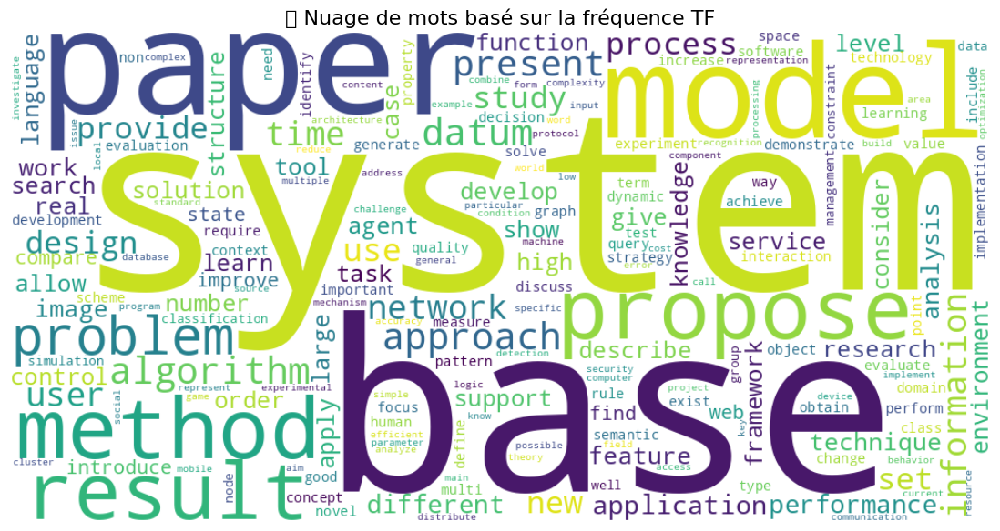

In [ ]:
from wordcloud import WordCloud
import matplotlib.pyplot as plt

# On va utiliser la version TF pour visualiser les mots les plus fréquents
tf_freq_dict = {tf_vocab[i]: tf_mean[i] for i in range(len(tf_vocab))}

# Générer le nuage de mots
wordcloud = WordCloud(width=1000, height=500, background_color='white').generate_from_frequencies(tf_freq_dict)

# Afficher
plt.figure(figsize=(15, 7))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title("🌥️ Nuage de mots basé sur la fréquence TF", fontsize=16)
plt.show()


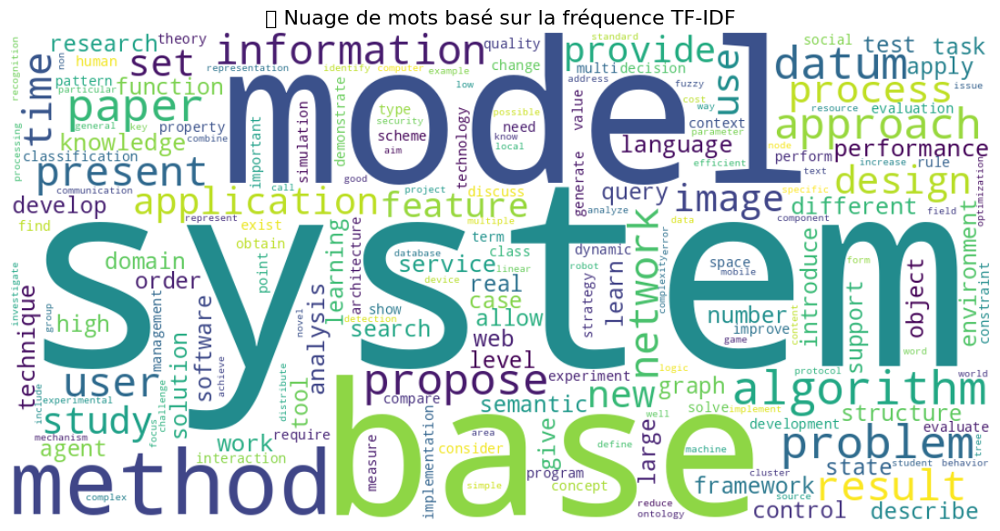

In [ ]:
from wordcloud import WordCloud
import matplotlib.pyplot as plt

# On va utiliser la version TF pour visualiser les mots les plus fréquents
tfidf_freq_dict = {tfidf_vocab[i]: tfidf_mean[i] for i in range(len(tfidf_vocab))}

# Générer le nuage de mots
wordcloud = WordCloud(width=1000, height=500, background_color='white').generate_from_frequencies(tfidf_freq_dict)

# Afficher
plt.figure(figsize=(15, 7))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title("🌥️ Nuage de mots basé sur la fréquence TF-IDF", fontsize=16)
plt.show()


# Exercice 3

In [ ]:
from sklearn.metrics.pairwise import cosine_similarity
import numpy as np

# Fonction de recherche
def search(query, vectorizer, matrix, docs, top_n=5):
    # Nettoyer la requête comme les abstracts
    query_cleaned = clean_text_spacy(query)

    # Transformer la requête en vecteur
    query_vec = vectorizer.transform([query_cleaned])

    # Calculer la similarité cosinus avec tous les documents
    similarities = cosine_similarity(query_vec, matrix).flatten()

    # Récupérer les indices des meilleurs scores
    top_indices = similarities.argsort()[::-1][:top_n]

    # Afficher les meilleurs résultats
    print(f"\n🔎 Résultats pour la requête : \"{query}\"")
    for i in top_indices:
        print(f"\n📄 Titre : {df_cleaned.iloc[i]['title']}")
        print(f"🧠 Année : {df_cleaned.iloc[i]['year']} | Venue : {df_cleaned.iloc[i]['venue']}")
        print(f"📝 Résumé : {df_cleaned.iloc[i]['abstract'][:300]}...")
        print(f"📊 Score : {similarities[i]:.4f}")


In [ ]:
import spacy

# Charger le modèle spaCy (si ce n’est pas déjà fait)
nlp = spacy.load("en_core_web_sm")

# Fonction de nettoyage pour une seule requête
def clean_text_spacy(text):
    if not isinstance(text, str):
        return ""
    doc = nlp(text.lower())
    tokens = [
        token.lemma_ for token in doc
        if not token.is_stop and token.is_alpha and len(token.text) > 2
    ]
    return " ".join(tokens)


In [ ]:
# Exemple d'appel de la fonction
search("deep learning for image recognition", tfidf_vectorizer, X_tfidf, df_cleaned, top_n=5)


🔎 Résultats pour la requête : "deep learning for image recognition"

📄 Titre : Risk Management for IT in the Large
🧠 Année : 1999 | Venue : conference on advanced information systems engineering
📝 Résumé : This paper presents a systematic approach to manage the risks within the acquisition of services and systems. The risk management approach is based upon situational factors which are root causes of risks. Strategy options for a service execution approach and a service control approach are offered to...
📊 Score : 0.4440

📄 Titre : Mobile-agent mediated place oriented communication
🧠 Année : 1999 | Venue : cooperative information agents
📝 Résumé : When we communicate with others in a most primitive way like face-to-face conversation, we normally gather at a common physical place. This physical constraint has been recognized as an obstacle against free communication. To relax this constraint, modern communication systems like post, telephone, ...
📊 Score : 0.3970

📄 Titre : Generating 

# Exercice 4

In [ ]:
# Garder seulement les lignes sans NaN pour clean_abstract (comme les documents)
df_cluster = df_cleaned[df_cleaned["clean_abstract"].notna()].copy()
from sklearn.cluster import KMeans

n_clusters = 5
kmeans = KMeans(n_clusters=n_clusters, random_state=42)
clusters = kmeans.fit_predict(X_tfidf)

# Ajouter les labels dans df_cluster, pas df_cleaned
df_cluster["cluster"] = clusters

# Afficher un aperçu
for i in range(n_clusters):
    print(f"\n🌀 Cluster {i} :")
    print(df_cluster[df_cluster["cluster"] == i]["title"].head(3).to_string(index=False))



Exception ignored on calling ctypes callback function: <function ThreadpoolController._find_libraries_with_dl_iterate_phdr.<locals>.match_library_callback at 0x794975f5d580>
Traceback (most recent call last):
  File "/usr/local/lib/python3.11/dist-packages/threadpoolctl.py", line 1005, in match_library_callback
    self._make_controller_from_path(filepath)
  File "/usr/local/lib/python3.11/dist-packages/threadpoolctl.py", line 1187, in _make_controller_from_path
    lib_controller = controller_class(
                     ^^^^^^^^^^^^^^^^^
  File "/usr/local/lib/python3.11/dist-packages/threadpoolctl.py", line 114, in __init__
    self.dynlib = ctypes.CDLL(filepath, mode=_RTLD_NOLOAD)
                  ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/usr/lib/python3.11/ctypes/__init__.py", line 376, in __init__
    self._handle = _dlopen(self._name, mode)
                   ^^^^^^^^^^^^^^^^^^^^^^^^^
OSError: dlopen() error



🌀 Cluster 0 :
Word pairs in language modeling for information...
  A general semantic analyser for data base access
SPIN Query Tools for De-identified Research on ...

🌀 Cluster 1 :
Breast Cancer Identification Based on Thermal A...
Automated Object Identification and Position Es...
Quality Assessment on User Generated Image for ...

🌀 Cluster 2 :
Hypergraph Transversal Computation with Binary ...
        PSO-Based Design of RF Integrated Inductor
Inserting rhetorical predicates for quasi-abstr...

🌀 Cluster 3 :
Comparison of GARCH, Neural Network and Support...
Identifying Psychological Theme Words from Emot...
Multisymplectic Spectral Methods for the Gross-...

🌀 Cluster 4 :
Preliminary Design of a Network Protocol Learni...
A methodology for the physically accurate visua...
Knowledge Engineering for Affective Bi-Modal In...


In [ ]:
print("\n📊 Répartition des documents par cluster :")
for i, count in df_cluster["cluster"].value_counts().sort_index().items():
    print(f" - Cluster {i} : {count} documents")



📊 Répartition des documents par cluster :
 - Cluster 0 : 1474 documents
 - Cluster 1 : 1413 documents
 - Cluster 2 : 2669 documents
 - Cluster 3 : 9141 documents
 - Cluster 4 : 5521 documents


In [ ]:
from sklearn.decomposition import LatentDirichletAllocation
from sklearn.feature_extraction.text import CountVectorizer

# 🔹 Filtrer les abstracts non vides
df_lda = df_cleaned[df_cleaned["clean_abstract"].notna()].copy()
documents = df_lda["clean_abstract"].astype(str).tolist()

# 1. Vectorisation avec CountVectorizer
cv = CountVectorizer(max_features=5000)
X_cv = cv.fit_transform(documents)

# 2. LDA
n_topics = 5
lda_model = LatentDirichletAllocation(n_components=n_topics, random_state=42)
lda_model.fit(X_cv)

# 3. Attribution du thème dominant
topic_distributions = lda_model.transform(X_cv)
df_lda["lda_topic"] = topic_distributions.argmax(axis=1)



In [ ]:
print("\n📊 Répartition des documents par thème LDA :")
print(df_lda["lda_topic"].value_counts().sort_index())



📊 Répartition des documents par thème LDA :
lda_topic
0    5331
1    4779
2    4247
3    2868
4    2993
Name: count, dtype: int64


In [ ]:
def print_top_words(model, feature_names, n_top_words=10):
    for topic_idx, topic in enumerate(model.components_):
        print(f"\n🔸 Thème {topic_idx}:")
        top_features = topic.argsort()[:-n_top_words - 1:-1]
        for i in top_features:
            print(f" - {feature_names[i]}")

# Afficher les mots les plus représentatifs de chaque thème
print_top_words(lda_model, cv.get_feature_names_out())



🔸 Thème 0:
 - system
 - paper
 - user
 - model
 - design
 - process
 - study
 - research
 - service
 - base

🔸 Thème 1:
 - problem
 - algorithm
 - model
 - paper
 - set
 - base
 - result
 - method
 - time
 - function

🔸 Thème 2:
 - method
 - image
 - propose
 - base
 - model
 - result
 - feature
 - paper
 - algorithm
 - datum

🔸 Thème 3:
 - datum
 - information
 - base
 - user
 - system
 - query
 - paper
 - web
 - semantic
 - approach

🔸 Thème 4:
 - network
 - system
 - propose
 - paper
 - time
 - base
 - performance
 - application
 - node
 - protocol


# Exercice 5

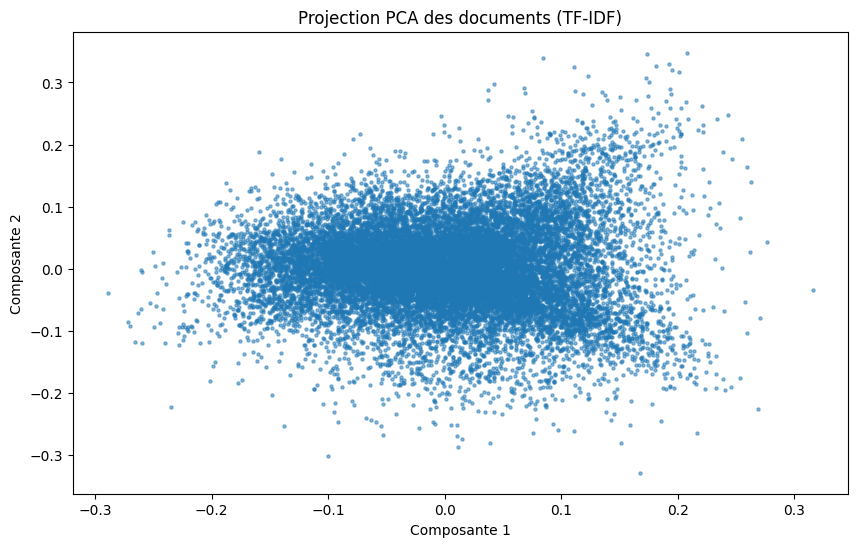

In [ ]:
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt

# ⚠️ Utiliser le DataFrame sans NaN pour clean_abstract
df_viz = df_cleaned[df_cleaned["clean_abstract"].notna()].copy()

# Matrice dense
X_dense = X_tfidf.toarray()

# PCA
pca = PCA(n_components=2, random_state=42)
X_pca = pca.fit_transform(X_dense)

# Ajouter les colonnes de coordonnées au bon DataFrame
df_viz["x"] = X_pca[:, 0]
df_viz["y"] = X_pca[:, 1]

# Visualisation simple
plt.figure(figsize=(10, 6))
plt.scatter(df_viz["x"], df_viz["y"], alpha=0.5, s=5)
plt.title("Projection PCA des documents (TF-IDF)")
plt.xlabel("Composante 1")
plt.ylabel("Composante 2")
plt.show()



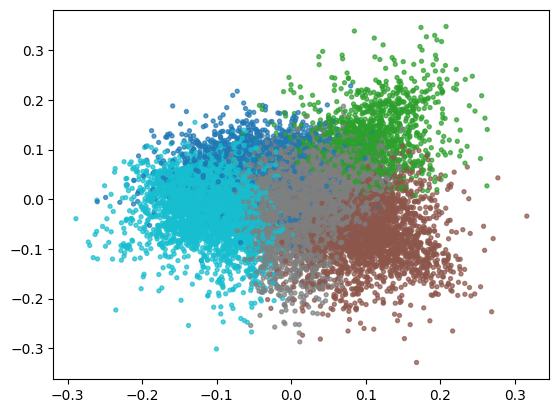

In [ ]:
plt.scatter(df_viz["x"], df_viz["y"], c=df_cluster["cluster"], cmap="tab10", s=8, alpha=0.7)

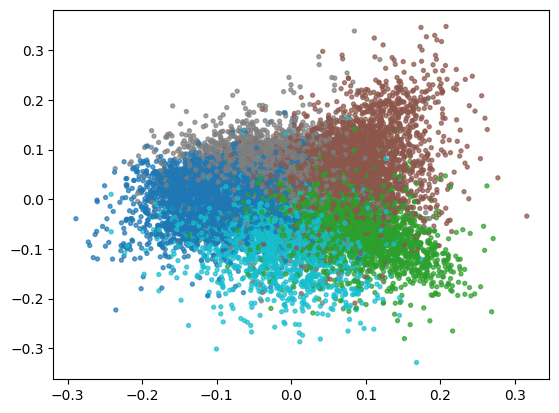

In [ ]:
plt.scatter(df_viz["x"], df_viz["y"], c=df_lda["lda_topic"], cmap="tab10", s=8, alpha=0.7)

In [ ]:
df_viz["lda_topic"] = df_lda["lda_topic"].values

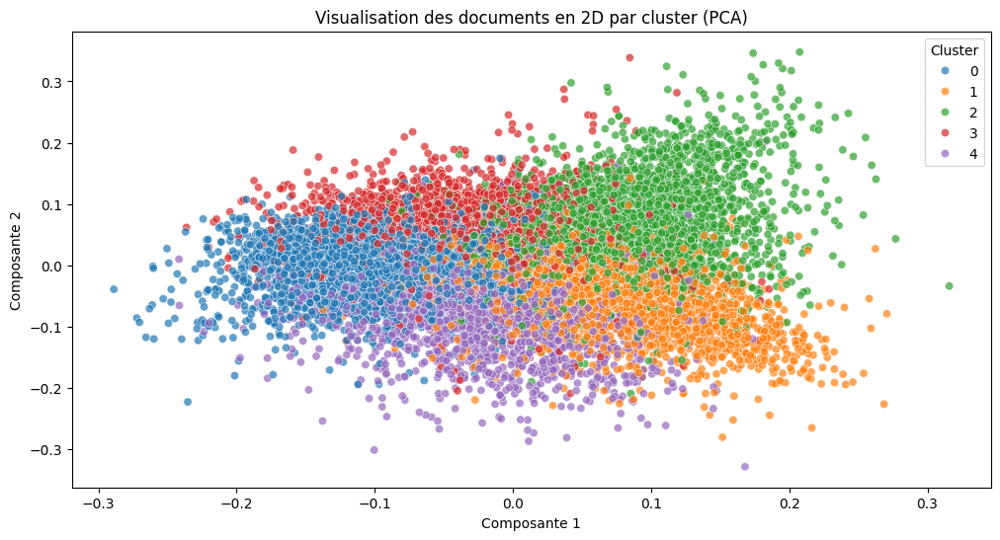

In [ ]:
import seaborn as sns

plt.figure(figsize=(12, 6))
sns.scatterplot(
    x="x", y="y",
    hue="lda_topic",
    palette="tab10",
    data= df_viz,
    legend="full",
    alpha=0.7
)

plt.title("Visualisation des documents en 2D par cluster (PCA)")
plt.xlabel("Composante 1")
plt.ylabel("Composante 2")
plt.legend(title="Cluster")
plt.show()


In [ ]:
df_viz["cluster"] = clusters

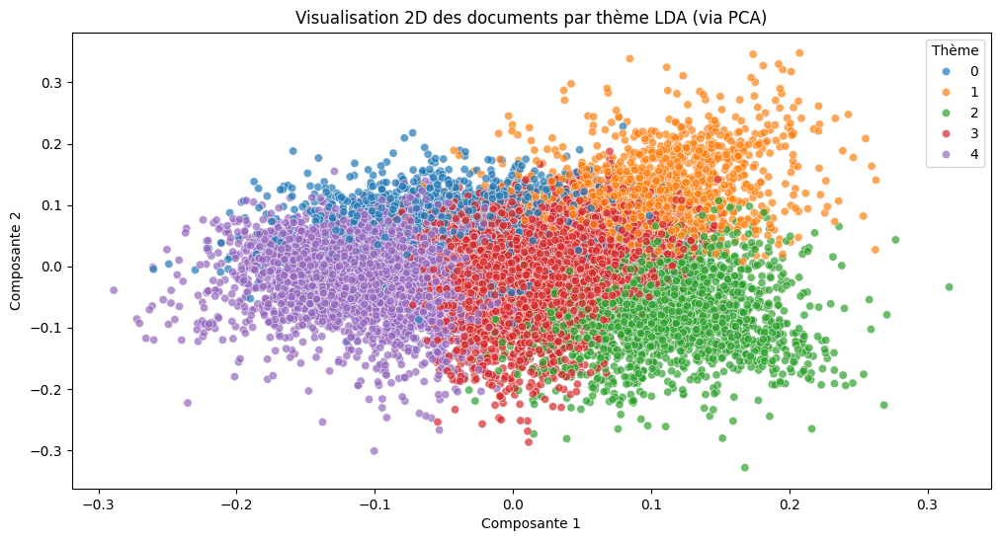

In [ ]:
plt.figure(figsize=(12, 6))
sns.scatterplot(
    x="x", y="y",
    hue="cluster",  # Coloration par thème LDA
    palette="tab10",
    data=df_viz,
    legend="full",
    alpha=0.7
)

plt.title("Visualisation 2D des documents par thème LDA (via PCA)")
plt.xlabel("Composante 1")
plt.ylabel("Composante 2")
plt.legend(title="Thème")
plt.show()


In [ ]:
!pip install plotly

In [ ]:
import plotly.express as px

fig = px.scatter(
    df_viz,
    x="x", y="y",
    color="lda_topic",
    hover_data=["title", "year", "venue"],
    title="📊 Visualisation interactive des documents par thème LDA",
    labels={"lda_topic": "Thème LDA"},
    width=900,
    height=600
)

fig.show()


In [ ]:
import plotly.express as px

fig = px.scatter(
    df_viz,
    x="x", y="y",
    color="cluster",
    hover_data=["title", "year", "venue"],
    title="📊 Visualisation interactive des documents par thème LDA",
    labels={"lda_topic": "Thème LDA"},
    width=900,
    height=600
)

fig.show()


# Exercice 6

In [ ]:
def get_top_words_per_topic(model, feature_names, n_top_words=10):
    topic_keywords = {}
    for topic_idx, topic in enumerate(model.components_):
        top_features_idx = topic.argsort()[::-1][:n_top_words]
        top_words = [feature_names[i] for i in top_features_idx]
        topic_keywords[topic_idx] = top_words
    return topic_keywords

# Appliquer la fonction
lda_keywords = get_top_words_per_topic(lda_model, cv.get_feature_names_out())

# Afficher joliment
for topic_id, words in lda_keywords.items():
    print(f"\n🔸 Thème {topic_id} : {', '.join(words)}")



🔸 Thème 0 : system, paper, user, model, design, process, study, research, service, base

🔸 Thème 1 : problem, algorithm, model, paper, set, base, result, method, time, function

🔸 Thème 2 : method, image, propose, base, model, result, feature, paper, algorithm, datum

🔸 Thème 3 : datum, information, base, user, system, query, paper, web, semantic, approach

🔸 Thème 4 : network, system, propose, paper, time, base, performance, application, node, protocol


/usr/local/lib/python3.11/dist-packages/IPython/core/pylabtools.py:151: UserWarning:

Glyph 127781 (\N{WHITE SUN BEHIND CLOUD}) missing from font(s) DejaVu Sans.



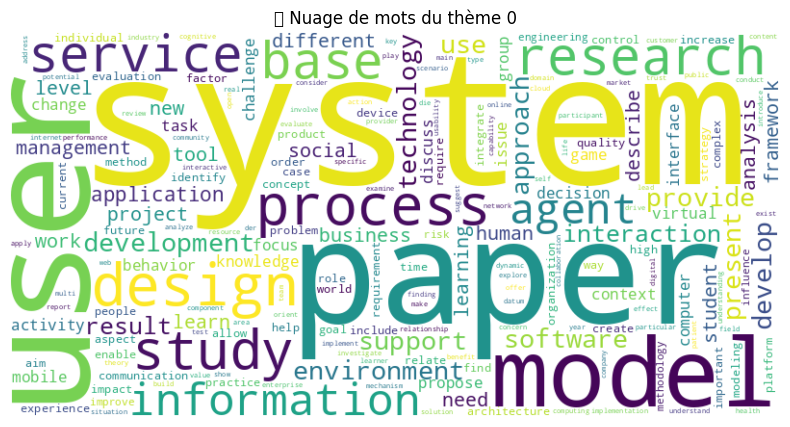

In [ ]:
from wordcloud import WordCloud

# Choisir un thème
topic_num = 0

# Générer un nuage à partir des poids du thème
topic_weights = lda_model.components_[topic_num]
word_freq = {
    cv.get_feature_names_out()[i]: topic_weights[i]
    for i in range(len(topic_weights))
}

wordcloud = WordCloud(width=800, height=400, background_color='white')
wordcloud = wordcloud.generate_from_frequencies(word_freq)

# Afficher
plt.figure(figsize=(10, 5))
plt.imshow(wordcloud, interpolation="bilinear")
plt.axis("off")
plt.title(f"🌥️ Nuage de mots du thème {topic_num}")
plt.show()


In [ ]:
# Afficher les 3 documents les plus proches du centre du thème donné
theme_id = 0
most_representative = df_viz[df_viz["lda_topic"] == theme_id].copy()
most_representative["topic_score"] = topic_distributions[df_viz["lda_topic"] == theme_id][:, theme_id]
top_docs = most_representative.sort_values("topic_score", ascending=False).head(3)

# Affichage
for i, row in top_docs.iterrows():
    print(f"\n📄 Titre : {row['title']}")
    print(f"📝 Résumé : {row['abstract'][:300]}...")
    print(f"📊 Score LDA : {row['topic_score']:.4f}")



📄 Titre : IMPROVEMENT OF A LECTURE GAME CONCEPT- Implementing Lecture Quiz 2.0
📝 Résumé : Nowadays, computer games are played in a technology-rich environment equipped with laptops, smart phones, game consoles (mobile and stationary), set-top boxes, and other digital devices. It is believed that the intrinsic motivation for games in young people can be combined with educational content a...
📊 Score LDA : 0.9980

📄 Titre : Using the Web to Enable Industry-University Collaboration: An Action Research Study of a Course Partnership
📝 Résumé : Introduction Industry-university partnerships, particularly those involving research universities, are commonplace and on the rise (Burnham, 1997). They allow industry access to quality research services at subsidized costs as well as to potential future employees while still in their formative year...
📊 Score LDA : 0.9972

📄 Titre : Agile web engineering (AWE) process: perceptions within a fortune 500 financial services company
📝 Résumé : The Agile 

# Exercice 7

## Exercice 7.1

In [ ]:
import networkx as nx

In [ ]:
import ast

# Convertir les chaînes JSON en vraies listes Python (si besoin)
df_cleaned["references"] = df_cleaned["references"].apply(lambda x: ast.literal_eval(x) if isinstance(x, str) else x)


In [ ]:
valid_ids = set(df_cleaned["id"])
G = nx.DiGraph()
G.add_nodes_from(valid_ids)

edges = []
for idx, row in df_cleaned.iterrows():
    src_id = row["id"]
    refs = row["references"]
    if isinstance(refs, list):
        internal_refs = [ref for ref in refs if ref in valid_ids]
        edges.extend((src_id, ref) for ref in internal_refs)

G.add_edges_from(edges)


In [ ]:
print(f"📊 Nombre de noeuds : {G.number_of_nodes()}")
print(f"🔗 Nombre d'arêtes : {G.number_of_edges()}")

📊 Nombre de noeuds : 20242
🔗 Nombre d'arêtes : 1731


## Exercice 7.2

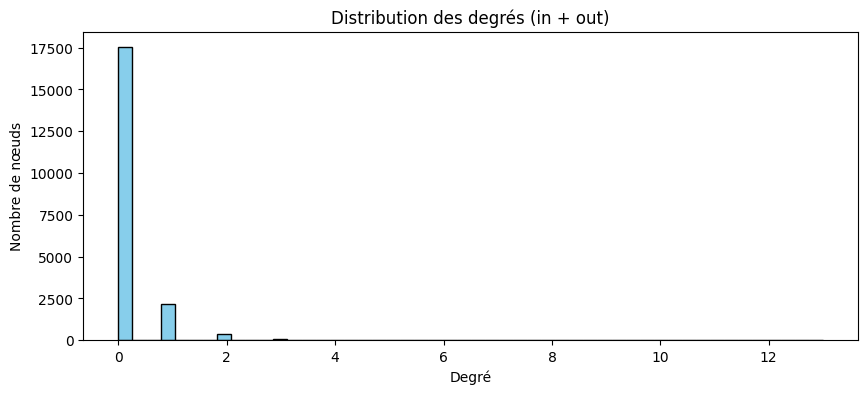

🔹 Densité du graphe : 0.000004
🔸 Nombre de composantes fortement connexes : 20224
🔸 Taille de la plus grande composante fortement connexe : 2
🔸 Coefficient de clustering moyen : 0.0042


In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# 1. Distribution des degrés
degrees = [deg for node, deg in G.degree()]
plt.figure(figsize=(10, 4))
plt.hist(degrees, bins=50, color='skyblue', edgecolor='black')
plt.title("Distribution des degrés (in + out)")
plt.xlabel("Degré")
plt.ylabel("Nombre de nœuds")
plt.show()

# 2. Densité
density = nx.density(G)
print(f"🔹 Densité du graphe : {density:.6f}")

# 3. Composantes fortement connexes
strong_components = list(nx.strongly_connected_components(G))
print(f"🔸 Nombre de composantes fortement connexes : {len(strong_components)}")
largest_scc = max(strong_components, key=len)
print(f"🔸 Taille de la plus grande composante fortement connexe : {len(largest_scc)}")

# 4. Coefficient de clustering (pour graphe non dirigé)
G_undirected = G.to_undirected()
avg_clustering = nx.average_clustering(G_undirected)
print(f"🔸 Coefficient de clustering moyen : {avg_clustering:.4f}")


## Exercice 7.3

In [ ]:
# Garder les 1000 nœuds avec le plus grand degré total
top_nodes = sorted(G.degree, key=lambda x: x[1], reverse=True)[:1000]
top_node_ids = [n for n, d in top_nodes]

# Extraire le sous-graphe
G_sub = G.subgraph(top_node_ids).copy()

print(f"Sous-graphe extrait : {G_sub.number_of_nodes()} nœuds, {G_sub.number_of_edges()} arêtes")


🧩 Sous-graphe extrait : 1000 nœuds, 503 arêtes


/usr/local/lib/python3.11/dist-packages/IPython/core/pylabtools.py:151: UserWarning:

Glyph 128279 (\N{LINK SYMBOL}) missing from font(s) DejaVu Sans.



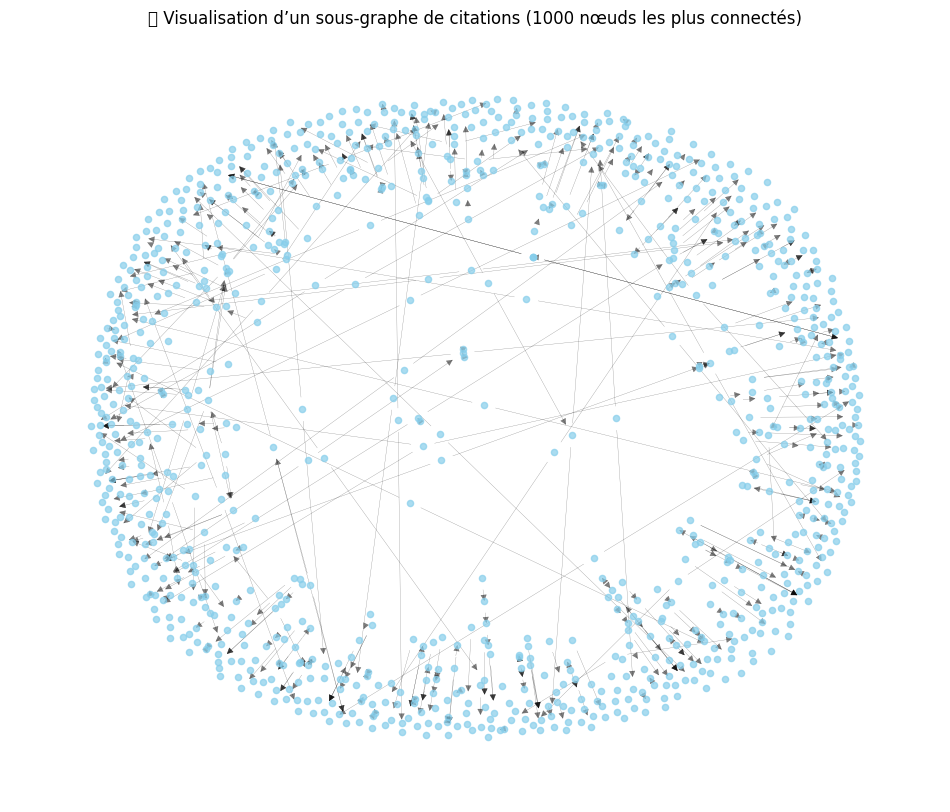

In [ ]:
plt.figure(figsize=(12, 10))
pos = nx.spring_layout(G_sub, seed=42)  # positionnement des nœuds

nx.draw_networkx_nodes(G_sub, pos, node_size=20, node_color='skyblue', alpha=0.7)
nx.draw_networkx_edges(G_sub, pos, width=0.2, alpha=0.5)
plt.title("🔗 Visualisation d’un sous-graphe de citations (1000 nœuds les plus connectés)")
plt.axis('off')
plt.show()


In [ ]:
!pip install scikit-network

In [ ]:
from scipy.sparse import csr_matrix
import numpy as np

# Réindexer les nœuds pour avoir des entiers (obligatoire pour scikit-network)
node_mapping = {node: i for i, node in enumerate(G_sub.nodes())}
reverse_mapping = {i: node for node, i in node_mapping.items()}

# Créer la matrice d’adjacence
edges = [(node_mapping[u], node_mapping[v]) for u, v in G_sub.edges()]
row, col = zip(*edges)
data = np.ones(len(edges))
adj_matrix = csr_matrix((data, (row, col)), shape=(len(G_sub.nodes()), len(G_sub.nodes())))


In [ ]:
# Set des IDs dans df_viz
valid_ids = set(df_viz["id"])

# Filtrer les nœuds du graphe sous forme de liste
valid_nodes = [n for n in G_sub.nodes() if n in valid_ids]

# Puis récupérer les topics uniquement pour ces nœuds
lda_labels = df_viz.set_index("id").loc[valid_nodes]["lda_topic"]
node_colors = lda_labels.astype(int).values


In [ ]:
print(f"🧩 Nœuds total dans G_sub : {len(G_sub.nodes())}")
print(f"✅ Nœuds présents dans df_viz : {len(valid_nodes)}")


🧩 Nœuds total dans G_sub : 1000
✅ Nœuds présents dans df_viz : 999


In [ ]:
from sknetwork.visualization import svg_graph
from IPython.display import SVG

image = svg_graph(adj_matrix, node_color=node_colors, node_size=5)
SVG(image)


## Exercice 7.4

In [ ]:
!pip install python-louvain

In [ ]:
import community.community_louvain as community_louvain

# Appliquer Louvain
partition = community_louvain.best_partition(G_undirected)
node_list = list(G_sub.nodes())
louvain_labels = [partition[node] for node in node_list]
image = svg_graph(adj_matrix, node_color=louvain_labels, node_size=5)
SVG(image)

In [ ]:
n_communities = len(set(louvain_labels))
print(f"🔸 Nombre de communautés détectées : {n_communities}")

🔸 Nombre de communautés détectées : 560


## Exercice 7.5

In [ ]:
!pip install node2vec

In [ ]:
from node2vec import Node2Vec

# Utiliser le graphe non dirigé
G_n2v = G_sub.to_undirected()

# Construire le modèle Node2Vec
node2vec = Node2Vec(
    G_n2v,
    dimensions=64,
    walk_length=30,
    num_walks=200,
    workers=2,
    seed=42
)

# Entraîner le modèle
n2v_model = node2vec.fit(window=10, min_count=1, batch_words=4)


Computing transition probabilities:   0%|          | 0/1000 [00:00<?, ?it/s]

In [ ]:
import numpy as np

node_ids = list(G_n2v.nodes())
embeddings = np.array([n2v_model.wv[str(node)] for node in node_ids])


/usr/local/lib/python3.11/dist-packages/IPython/core/pylabtools.py:151: UserWarning:

Glyph 128309 (\N{LARGE BLUE CIRCLE}) missing from font(s) DejaVu Sans.



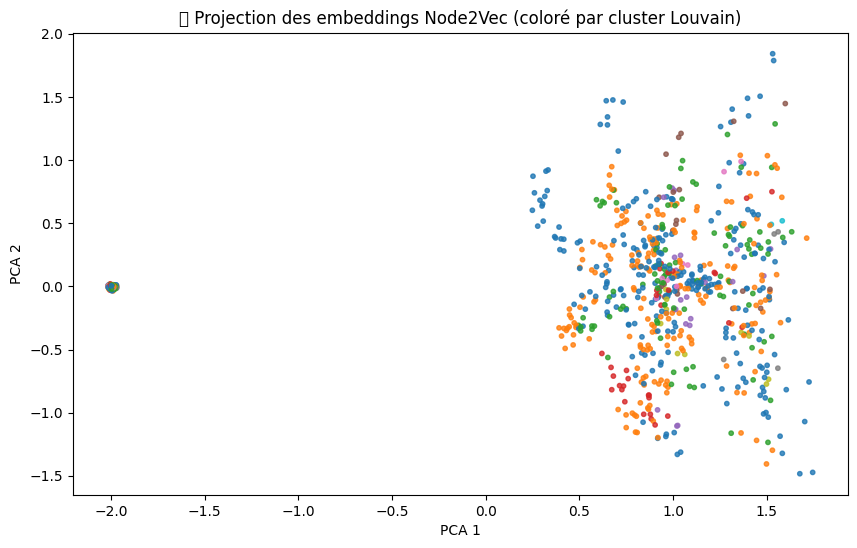

In [ ]:
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt

pca = PCA(n_components=2)
embeddings_2d = pca.fit_transform(embeddings)

# Coloration par cluster Louvain si dispo
colors = [partition[node] for node in node_ids]

plt.figure(figsize=(10, 6))
plt.scatter(embeddings_2d[:, 0], embeddings_2d[:, 1], c=colors, cmap="tab10", s=10, alpha=0.8)
plt.title("🔵 Projection des embeddings Node2Vec (coloré par cluster Louvain)")
plt.xlabel("PCA 1")
plt.ylabel("PCA 2")
plt.show()


## Exercice 7.6

In [ ]:
from sklearn.metrics import adjusted_rand_score, normalized_mutual_info_score

In [ ]:
# LDA vs KMeans
ari_lda_kmeans = adjusted_rand_score(df_viz["lda_topic"], df_viz["cluster"])
nmi_lda_kmeans = normalized_mutual_info_score(df_viz["lda_topic"], df_viz["cluster"])

# LDA vs Louvain (si disponible)
if "louvain_cluster" in df_viz.columns:
    ari_lda_louvain = adjusted_rand_score(df_viz["lda_topic"], df_viz["louvain_cluster"])
    nmi_lda_louvain = normalized_mutual_info_score(df_viz["lda_topic"], df_viz["louvain_cluster"])
else:
    ari_lda_louvain = nmi_lda_louvain = None


In [ ]:
print("🎯 Comparaison des clusters :\n")

print(f"🔸 LDA vs KMeans:")
print(f"    - ARI : {ari_lda_kmeans:.4f}")
print(f"    - NMI : {nmi_lda_kmeans:.4f}")

if ari_lda_louvain is not None:
    print(f"\n🔸 LDA vs Louvain:")
    print(f"    - ARI : {ari_lda_louvain:.4f}")
    print(f"    - NMI : {nmi_lda_louvain:.4f}")
else:
    print("\n⚠️ Louvain clustering non disponible dans le DataFrame.")


🎯 Comparaison des clusters :

🔸 LDA vs KMeans:
    - ARI : 0.2122
    - NMI : 0.2997

⚠️ Louvain clustering non disponible dans le DataFrame.


# Exercice 8

## Exercice 8.1

#### Methode 1 ( classe dernier mot de la conference )

In [ ]:
df_cleaned["class"] = df_cleaned["venue"].str.extract(r'(\w+)$')  # Prend le dernier mot du nom de la conférence

In [ ]:
# Créer une colonne text = title + clean_abstract
df_text = df_cleaned.copy()
df_text["text"] = (df_text["title"].fillna("") + " " + df_text["clean_abstract"].fillna("")).str.strip()

# Supprimer les lignes sans label
df_text = df_text[df_text["class"].notna()].copy()

# X = texte, y = classe
X = df_text["text"]
y = df_text["class"]

print(f"✅ Données prêtes : {len(X)} exemples - {y.nunique()} classes")

✅ Données prêtes : 14684 exemples - 368 classes


In [ ]:
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.model_selection import train_test_split

# Vectoriser le texte
vectorizer = TfidfVectorizer(max_features=5000)
X_tfidf = vectorizer.fit_transform(X)

# Split train/test
X_train, X_test, y_train, y_test = train_test_split(X_tfidf, y, test_size=0.2, random_state=42)

print(f"🧪 Entraînement : {X_train.shape[0]} - Test : {X_test.shape[0]}")


🧪 Entraînement : 11747 - Test : 2937


In [ ]:
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import classification_report, accuracy_score

# Modèle
clf = LogisticRegression(max_iter=1000)
clf.fit(X_train, y_train)

# Prédictions
y_pred = clf.predict(X_test)

# Évaluation
print("📊 Résultats de classification :")
print(classification_report(y_test, y_pred))
print(f"✅ Accuracy : {accuracy_score(y_test, y_pred):.4f}")


📊 Résultats de classification :
                       precision    recall  f1-score   support

                    A       0.00      0.00      0.00         1
                  Ais       0.00      0.00      0.00         6
           Algorithms       0.00      0.00      0.00         6
             Analysis       0.00      0.00      0.00         4
             Aplicada       0.00      0.00      0.00         1
         Applications       0.50      0.04      0.07        25
          Aprendizaje       0.00      0.00      0.00         1
         Architecture       0.00      0.00      0.00         7
               Archiv       0.00      0.00      0.00         1
          Association       0.00      0.00      0.00         1
           Automatica       0.00      0.00      0.00         2
              Biology       0.00      0.00      0.00         2
            Biometals       0.00      0.00      0.00         1
             Bulletin       0.00      0.00      0.00         1
                    C 

/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



In [ ]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report, accuracy_score

# Modèle Random Forest
rf_clf = RandomForestClassifier(n_estimators=100, random_state=42)
rf_clf.fit(X_train, y_train)

# Prédictions
y_pred_rf = rf_clf.predict(X_test)

# Évaluation
print("🌲 Résultats Random Forest :")
print(classification_report(y_test, y_pred_rf))
print(f"✅ Accuracy : {accuracy_score(y_test, y_pred_rf):.4f}")


🌲 Résultats Random Forest :
                       precision    recall  f1-score   support

                    A       0.00      0.00      0.00         1
                  Ais       0.00      0.00      0.00         6
           Algorithms       0.00      0.00      0.00         6
             Analysis       0.00      0.00      0.00         4
             Aplicada       0.00      0.00      0.00         1
         Applications       0.67      0.08      0.14        25
          Aprendizaje       0.00      0.00      0.00         1
         Architecture       0.00      0.00      0.00         7
               Archiv       0.00      0.00      0.00         1
          Association       0.00      0.00      0.00         1
           Automatica       0.00      0.00      0.00         2
              Biology       0.00      0.00      0.00         2
            Biometals       0.00      0.00      0.00         1
             Bulletin       0.00      0.00      0.00         1
                    C     

/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning:

Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.

/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning:

Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.

/usr/local/lib/python3.11/dist-p

#### methode 2 (8 classes : artificial intelligence,data science,interface,computer vision,....)

In [ ]:
def map_venue_to_class(venue):
    if not isinstance(venue, str):
        return 8  # other

    v = venue.lower()

    if any(kw in v for kw in [
        "machine learning", "decision", "agent", "language processing", "nlp", "ai", "artificial intelligence"
    ]):
        return 1  # artificial intelligence

    elif any(kw in v for kw in [
        "database", "data mining", "data science", "information system", "cleaning", "business intelligence"
    ]):
        return 2  # data science

    elif any(kw in v for kw in [
        "visualization", "interface", "interaction", "human-computer", "hci"
    ]):
        return 3  # interface

    elif any(kw in v for kw in [
        "vision", "image", "virtual reality", "2d", "3d", "object detection"
    ]):
        return 4  # computer vision

    elif any(kw in v for kw in [
        "network", "system", "security", "iot", "web", "mobile"
    ]):
        return 5  # network

    elif any(kw in v for kw in [
        "theory", "proof", "bound", "calculability", "game theory", "compilation", "theorem"
    ]):
        return 6  # theoretical computer science

    elif any(kw in v for kw in [
        "humanities", "biology", "application", "education", "health"
    ]):
        return 7  # specific applications

    else:
        return 8  # other


In [ ]:
df_cleaned["class"] = df_cleaned["venue"].apply(map_venue_to_class)

class
1     2809
2     1151
3      360
4      814
5     2075
6      320
7      623
8    12090
Name: count, dtype: int64


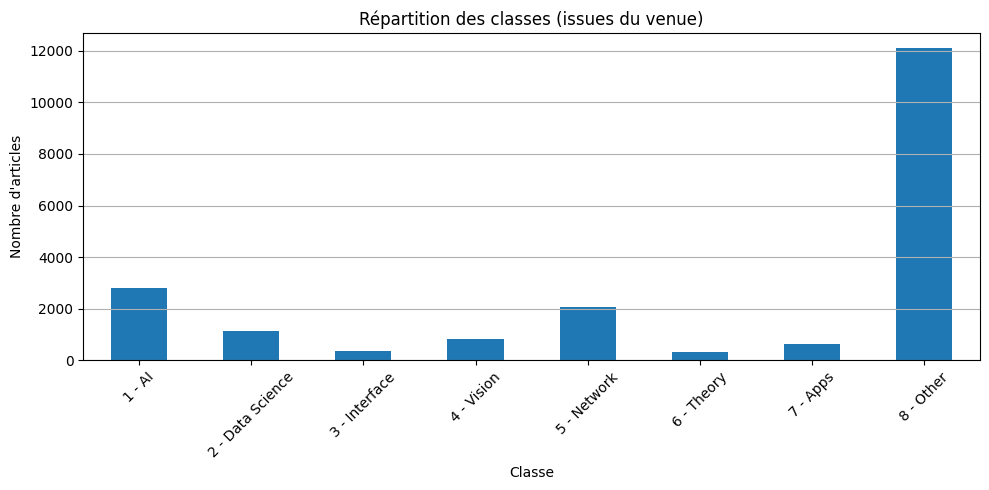

In [ ]:
print(df_cleaned["class"].value_counts().sort_index())

labels = [
    "1 - AI", "2 - Data Science", "3 - Interface", "4 - Vision",
    "5 - Network", "6 - Theory", "7 - Apps", "8 - Other"
]

import matplotlib.pyplot as plt

plt.figure(figsize=(10, 5))
df_cleaned["class"].value_counts().sort_index().plot(kind="bar")
plt.xticks(ticks=range(8), labels=labels, rotation=45)
plt.title("Répartition des classes (issues du venue)")
plt.xlabel("Classe")
plt.ylabel("Nombre d'articles")
plt.grid(axis='y')
plt.tight_layout()
plt.show()


In [ ]:
# Créer le champ texte
df_text = df_cleaned.copy()
df_text["text"] = (df_text["title"].fillna("") + " " + df_text["clean_abstract"].fillna("")).str.strip()

# Ne garder que les articles avec classe définie (1 à 8)
df_text = df_text[df_text["class"].notna()].copy()

# X = texte, y = classe
X = df_text["text"]
y = df_text["class"]


In [ ]:
from sklearn.feature_extraction.text import TfidfVectorizer

vectorizer = TfidfVectorizer(max_features=5000)
X_tfidf = vectorizer.fit_transform(X)


In [ ]:
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(X_tfidf, y, test_size=0.2, random_state=42)


In [ ]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report, accuracy_score

clf_rf = RandomForestClassifier(n_estimators=100, random_state=42)
clf_rf.fit(X_train, y_train)

# Prédictions
y_pred = clf_rf.predict(X_test)


In [ ]:
print("📊 Rapport de classification :")
print(classification_report(y_test, y_pred))
print(f"✅ Accuracy globale : {accuracy_score(y_test, y_pred):.4f}")


📊 Rapport de classification :
              precision    recall  f1-score   support

           1       0.60      0.07      0.13       571
           2       0.50      0.00      0.01       212
           3       0.00      0.00      0.00        64
           4       0.75      0.02      0.04       153
           5       0.67      0.01      0.03       438
           6       0.00      0.00      0.00        59
           7       0.00      0.00      0.00       119
           8       0.61      0.99      0.75      2433

    accuracy                           0.61      4049
   macro avg       0.39      0.14      0.12      4049
weighted avg       0.58      0.61      0.47      4049

✅ Accuracy globale : 0.6066


/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



<ipython-input-74-9dad9a06d80b>:19: UserWarning:

Glyph 129504 (\N{BRAIN}) missing from font(s) DejaVu Sans.

/usr/local/lib/python3.11/dist-packages/IPython/core/pylabtools.py:151: UserWarning:

Glyph 129504 (\N{BRAIN}) missing from font(s) DejaVu Sans.



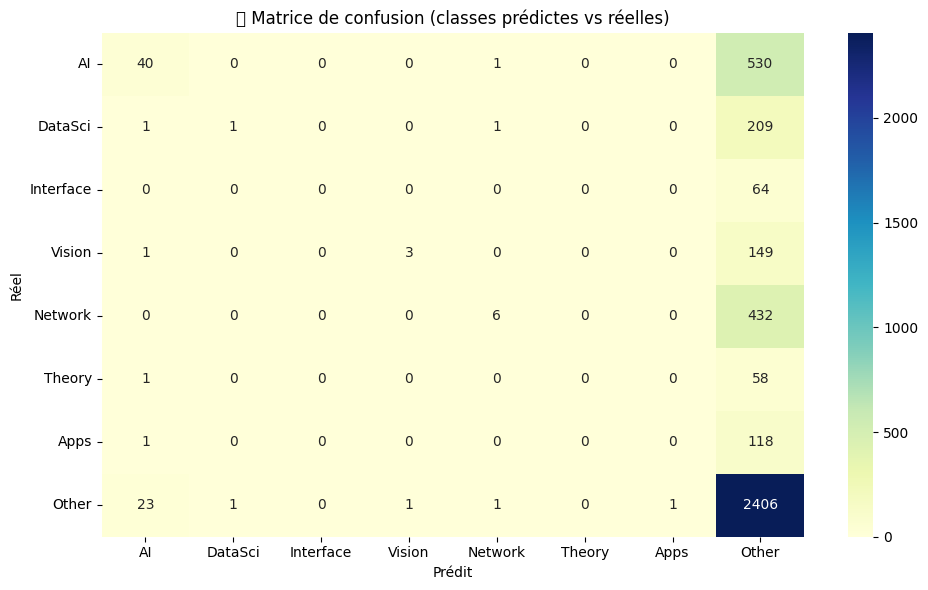

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix

labels = [1, 2, 3, 4, 5, 6, 7, 8]
label_names = [
    "AI", "DataSci", "Interface", "Vision",
    "Network", "Theory", "Apps", "Other"
]

cm = confusion_matrix(y_test, y_pred, labels=labels)

plt.figure(figsize=(10, 6))
sns.heatmap(cm, annot=True, fmt="d", cmap="YlGnBu",
            xticklabels=label_names, yticklabels=label_names)
plt.title("🧠 Matrice de confusion (classes prédictes vs réelles)")
plt.xlabel("Prédit")
plt.ylabel("Réel")
plt.tight_layout()
plt.show()


data desequilibre on vas ajouter abstract et titre pour classer les donnees

In [ ]:
def map_article_to_class1(row):
    text = f"{row.get('title', '')} {row.get('venue', '')} {row.get('abstract', '')}".lower()

    if any(kw in text for kw in [
        "machine learning", "deep learning", "reinforcement learning",
        "decision", "agent", "natural language", "nlp", "semantic web", "recommender"
    ]):
        return 1  # artificial intelligence

    elif any(kw in text for kw in [
        "database", "data mining", "data science", "etl", "data warehouse",
        "information system", "cleaning", "business intelligence", "big data"
    ]):
        return 2  # data science

    elif any(kw in text for kw in [
        "interface", "interaction", "visualization", "augmented reality",
        "gesture", "eye tracking", "hci", "human-computer"
    ]):
        return 3  # interface

    elif any(kw in text for kw in [
        "image", "vision", "virtual reality", "object detection",
        "face recognition", "image segmentation", "2d", "3d"
    ]):
        return 4  # computer vision

    elif any(kw in text for kw in [
        "network", "system", "security", "iot", "web", "mobile",
        "cybersecurity", "wifi", "bluetooth"
    ]):
        return 5  # network

    elif any(kw in text for kw in [
        "theory", "proof", "bound", "calculability", "automata",
        "formal method", "game theory", "complexity", "compilation"
    ]):
        return 6  # theoretical computer science

    elif any(kw in text for kw in [
        "application", "health", "education", "biology", "covid",
        "medicine", "climate", "environment", "linguistics", "humanities"
    ]):
        return 7  # specific applications

    else:
        return 8  # other


In [ ]:
df_cleaned["class"] = df_cleaned.apply(map_article_to_class1, axis=1)


<ipython-input-77-774ca497c329>:16: UserWarning:

Glyph 128202 (\N{BAR CHART}) missing from font(s) DejaVu Sans.

/usr/local/lib/python3.11/dist-packages/IPython/core/pylabtools.py:151: UserWarning:

Glyph 128202 (\N{BAR CHART}) missing from font(s) DejaVu Sans.



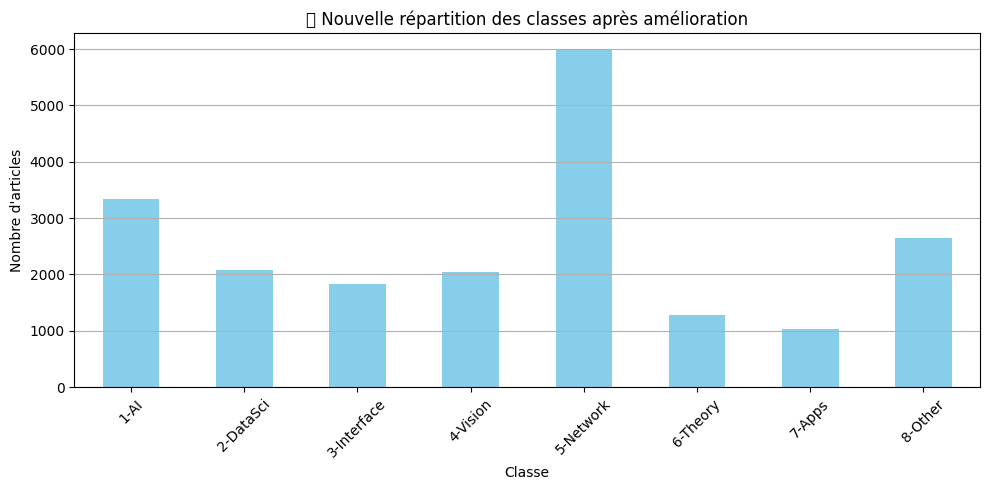

In [ ]:
import matplotlib.pyplot as plt

counts = df_cleaned["class"].value_counts().sort_index()
labels = [
    "1-AI", "2-DataSci", "3-Interface", "4-Vision",
    "5-Network", "6-Theory", "7-Apps", "8-Other"
]

plt.figure(figsize=(10, 5))
counts.plot(kind="bar", color="skyblue")
plt.xticks(ticks=range(8), labels=labels, rotation=45)
plt.title("📊 Nouvelle répartition des classes après amélioration")
plt.xlabel("Classe")
plt.ylabel("Nombre d'articles")
plt.grid(axis='y')
plt.tight_layout()
plt.show()


data comme meme equilibrer

In [ ]:
# Créer le texte d'entrée
df_text = df_cleaned.copy()
df_text["text"] = (df_text["title"].fillna("") + " " + df_text["clean_abstract"].fillna("")).str.strip()

# Supprimer les lignes sans classe (par précaution)
df_text = df_text[df_text["class"].notna()].copy()

# Définir X et y
X = df_text["text"]
y = df_text["class"]


In [ ]:
from sklearn.feature_extraction.text import TfidfVectorizer

vectorizer = TfidfVectorizer(max_features=5000)
X_tfidf = vectorizer.fit_transform(X)


In [ ]:
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(X_tfidf, y, test_size=0.2, random_state=42)


In [ ]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report, accuracy_score

# Créer le classifieur (⚖️ class_weight='balanced' recommandé)
clf = RandomForestClassifier(n_estimators=100, random_state=42, class_weight="balanced")
clf.fit(X_train, y_train)

# Prédiction
y_pred = clf.predict(X_test)

# Évaluation
print("📊 Rapport de classification :")
print(classification_report(y_test, y_pred))
print(f"✅ Accuracy globale : {accuracy_score(y_test, y_pred):.4f}")


📊 Rapport de classification :
              precision    recall  f1-score   support

           1       0.96      0.72      0.82       695
           2       0.87      0.49      0.63       414
           3       0.85      0.82      0.84       335
           4       0.82      0.75      0.78       408
           5       0.69      0.91      0.79      1197
           6       0.82      0.68      0.74       253
           7       0.76      0.32      0.45       221
           8       0.65      0.88      0.75       526

    accuracy                           0.76      4049
   macro avg       0.80      0.70      0.72      4049
weighted avg       0.79      0.76      0.75      4049

✅ Accuracy globale : 0.7604


<ipython-input-82-63149f2168c4>:18: UserWarning:

Glyph 129504 (\N{BRAIN}) missing from font(s) DejaVu Sans.

/usr/local/lib/python3.11/dist-packages/IPython/core/pylabtools.py:151: UserWarning:

Glyph 129504 (\N{BRAIN}) missing from font(s) DejaVu Sans.



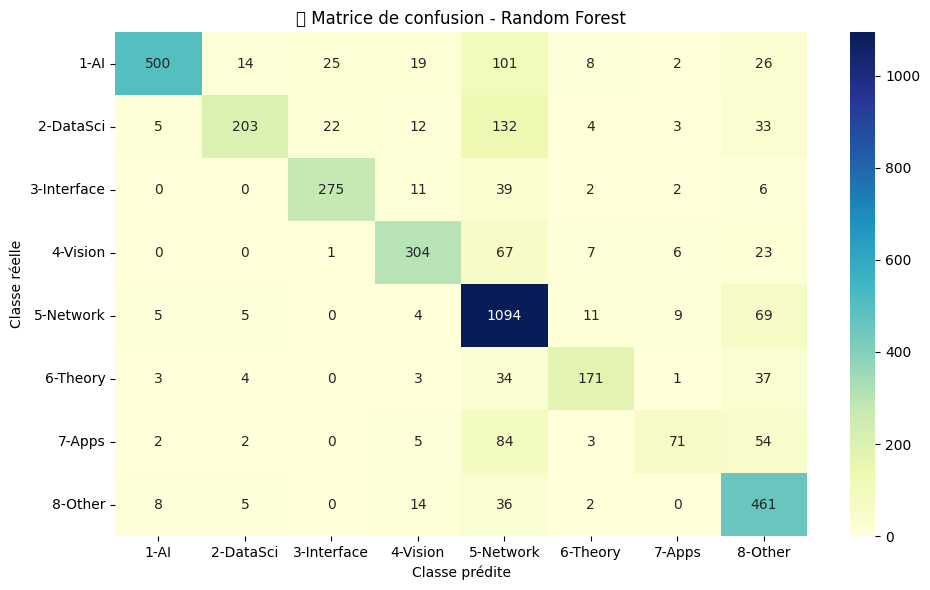

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import confusion_matrix

labels = [1, 2, 3, 4, 5, 6, 7, 8]
label_names = [
    "1-AI", "2-DataSci", "3-Interface", "4-Vision",
    "5-Network", "6-Theory", "7-Apps", "8-Other"
]

cm = confusion_matrix(y_test, y_pred, labels=labels)

plt.figure(figsize=(10, 6))
sns.heatmap(cm, annot=True, fmt="d", cmap="YlGnBu", xticklabels=label_names, yticklabels=label_names)
plt.title("🧠 Matrice de confusion - Random Forest")
plt.xlabel("Classe prédite")
plt.ylabel("Classe réelle")
plt.tight_layout()
plt.show()


#### methode 3 (GCN)

In [ ]:
# Exécuter ça dans une cellule Colab
!pip install torch-scatter torch-sparse torch-geometric -f https://data.pyg.org/whl/torch-2.0.0+cpu.html

Looking in links: https://data.pyg.org/whl/torch-2.0.0+cpu.html


In [ ]:
from sklearn.feature_extraction.text import TfidfVectorizer
import torch

# Texte = titre + résumé nettoyé
df_viz = df_cleaned[df_cleaned["class"].notna() & df_cleaned["clean_abstract"].notna()].copy()
df_viz["text"] = (df_viz["title"].fillna("") + " " + df_viz["clean_abstract"].fillna("")).str.strip()

# TF-IDF
vectorizer = TfidfVectorizer(max_features=1000)
X_tfidf = vectorizer.fit_transform(df_viz["text"])
X_tensor = torch.tensor(X_tfidf.toarray(), dtype=torch.float)


In [ ]:
import networkx as nx
from torch_geometric.utils import from_networkx

# Sous-graphe avec seulement les articles présents dans df_viz
valid_ids = set(df_viz["id"])
G_sub = nx.DiGraph()
G_sub.add_nodes_from(valid_ids)

for idx, row in df_viz.iterrows():
    src = row["id"]
    refs = row["references"]
    if isinstance(refs, list):
        for tgt in refs:
            if tgt in valid_ids:
                G_sub.add_edge(src, tgt)

# Remapper les IDs → index 0...n
id_map = {id_: i for i, id_ in enumerate(df_viz["id"])}
G_sub = nx.relabel_nodes(G_sub, id_map)

# Convertir vers PyG
data = from_networkx(G_sub)
data.x = X_tensor


/usr/local/lib/python3.11/dist-packages/torch_geometric/typing.py:86: UserWarning:

An issue occurred while importing 'torch-scatter'. Disabling its usage. Stacktrace: /usr/local/lib/python3.11/dist-packages/torch_scatter/_version_cpu.so: undefined symbol: _ZN3c1017RegisterOperatorsD1Ev

/usr/local/lib/python3.11/dist-packages/torch_geometric/typing.py:124: UserWarning:

An issue occurred while importing 'torch-sparse'. Disabling its usage. Stacktrace: /usr/local/lib/python3.11/dist-packages/torch_sparse/_version_cpu.so: undefined symbol: _ZN3c1017RegisterOperatorsD1Ev



In [ ]:
from sklearn.model_selection import train_test_split

# Labels
y_tensor = torch.tensor(df_viz["class"].values, dtype=torch.long)
data.y = y_tensor

# Split
num_nodes = data.num_nodes
train_idx, test_idx = train_test_split(range(num_nodes), test_size=0.2, random_state=42)

data.train_mask = torch.zeros(num_nodes, dtype=torch.bool)
data.test_mask = torch.zeros(num_nodes, dtype=torch.bool)
data.train_mask[train_idx] = True
data.test_mask[test_idx] = True


In [ ]:
import torch.nn.functional as F
from torch_geometric.nn import GCNConv

class GCN(torch.nn.Module):
    def __init__(self, in_channels, hidden_channels, out_channels):
        super().__init__()
        self.conv1 = GCNConv(in_channels, hidden_channels)
        self.conv2 = GCNConv(hidden_channels, out_channels)

    def forward(self, x, edge_index):
        x = self.conv1(x, edge_index)
        x = F.relu(x)
        x = F.dropout(x, training=self.training)
        return self.conv2(x, edge_index)


In [ ]:
# Juste avant d’attribuer les labels à data.y
df_viz["class_index"] = df_viz["class"] - 1  # passe de 1–8 → 0–7
data.y = torch.tensor(df_viz["class_index"].values, dtype=torch.long)

In [ ]:
model = GCN(in_channels=data.x.shape[1], hidden_channels=64, out_channels=8)
optimizer = torch.optim.Adam(model.parameters(), lr=0.01)
loss_fn = torch.nn.CrossEntropyLoss()

for epoch in range(1, 201):
    model.train()
    optimizer.zero_grad()
    out = model(data.x, data.edge_index)
    loss = loss_fn(out[data.train_mask], data.y[data.train_mask])
    loss.backward()
    optimizer.step()

    if epoch % 20 == 0:
        print(f"Epoch {epoch:03d} - Loss: {loss.item():.4f}")


Epoch 020 - Loss: 1.5022
Epoch 040 - Loss: 1.2334
Epoch 060 - Loss: 1.0589
Epoch 080 - Loss: 0.9345
Epoch 100 - Loss: 0.8389
Epoch 120 - Loss: 0.7565
Epoch 140 - Loss: 0.6880
Epoch 160 - Loss: 0.6338
Epoch 180 - Loss: 0.5775
Epoch 200 - Loss: 0.5409


In [ ]:
model.eval()
out = model(data.x, data.edge_index)
pred = out.argmax(dim=1)

from sklearn.metrics import classification_report

print("📊 Résultats GNN (test set) :")
print(classification_report(
    data.y[data.test_mask].cpu().numpy(),
    pred[data.test_mask].cpu().numpy()
))


📊 Résultats GNN (test set) :
              precision    recall  f1-score   support

           0       0.68      0.61      0.64       677
           1       0.49      0.39      0.43       412
           2       0.66      0.57      0.61       357
           3       0.61      0.55      0.58       416
           4       0.59      0.73      0.65      1193
           5       0.54      0.47      0.50       253
           6       0.35      0.26      0.30       197
           7       0.50      0.54      0.52       539

    accuracy                           0.58      4044
   macro avg       0.55      0.51      0.53      4044
weighted avg       0.58      0.58      0.57      4044



In [ ]:
model.eval()
out = model(data.x, data.edge_index)         # Logits
pred = out.argmax(dim=1)                     # Prédictions finales

<ipython-input-92-b60d6eefd4bb>:23: UserWarning:

Glyph 128202 (\N{BAR CHART}) missing from font(s) DejaVu Sans.

/usr/local/lib/python3.11/dist-packages/IPython/core/pylabtools.py:151: UserWarning:

Glyph 128202 (\N{BAR CHART}) missing from font(s) DejaVu Sans.



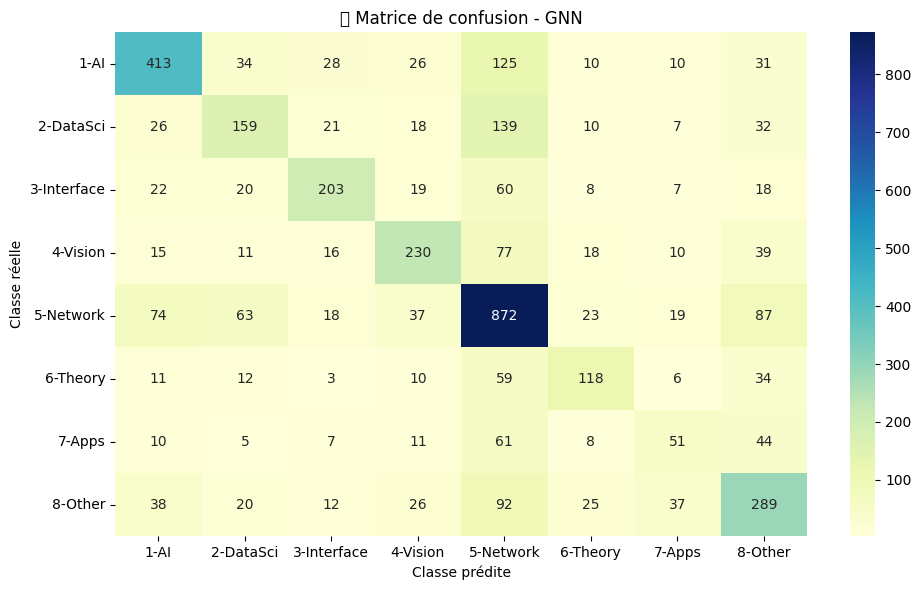

In [ ]:
from sklearn.metrics import confusion_matrix
import matplotlib.pyplot as plt
import seaborn as sns

# Y_true et Y_pred sur le test set uniquement
y_true = data.y[data.test_mask].cpu().numpy()
y_pred = pred[data.test_mask].cpu().numpy()

# Matrice de confusion
cm = confusion_matrix(y_true, y_pred)

# Noms des classes
labels = ["1-AI", "2-DataSci", "3-Interface", "4-Vision",
          "5-Network", "6-Theory", "7-Apps", "8-Other"]

# Affichage
plt.figure(figsize=(10, 6))
sns.heatmap(cm, annot=True, fmt="d", cmap="YlGnBu",
            xticklabels=labels, yticklabels=labels)
plt.title("📊 Matrice de confusion - GNN")
plt.xlabel("Classe prédite")
plt.ylabel("Classe réelle")
plt.tight_layout()
plt.show()


## EXERCICE 8.2

In [ ]:
from node2vec import Node2Vec
import networkx as nx
import numpy as np
import pandas as pd
from sklearn.metrics.pairwise import cosine_similarity
import ast

# 1. Sécuriser le champ authors (parfois sous forme de chaîne)
def safe_parse_authors(a):
    try:
        return ast.literal_eval(a) if isinstance(a, str) else a
    except:
        return []

df_cleaned["authors"] = df_cleaned["authors"].apply(safe_parse_authors)

# 2. Construire un graphe basé sur les citations
valid_ids = set(df_cleaned["id"])
G = nx.DiGraph()
G.add_nodes_from(valid_ids)

for _, row in df_cleaned.iterrows():
    src = row["id"]
    refs = row["references"]
    if isinstance(refs, list):
        for tgt in refs:
            if tgt in valid_ids:
                G.add_edge(src, tgt)

# Sous-graphe pour test (tu peux adapter à plus gros)
G_sub = nx.subgraph(G, list(valid_ids)[:1000])
G_n2v = G_sub.to_undirected()

# 3. Node2Vec
node2vec = Node2Vec(
    G_n2v,
    dimensions=64,
    walk_length=30,
    num_walks=200,
    workers=2,
    seed=42
)

model = node2vec.fit(window=10, min_count=1, batch_words=4)

# 4. Embeddings
node_ids = list(G_n2v.nodes())
node_embeddings = {str(node): model.wv[str(node)] for node in node_ids}

# 5. Lier les auteurs
df_embed = df_cleaned[df_cleaned["id"].isin(node_ids)].copy()
df_embed = df_embed[df_embed["authors"].apply(lambda x: isinstance(x, list) and len(x) > 0)]
df_embed = df_embed.explode("authors").rename(columns={"authors": "author"})

# 6. Moyenne des embeddings par auteur
author_vectors = {}
for author, group in df_embed.groupby("author"):
    vectors = []
    for doc_id in group["id"]:
        doc_id_str = str(doc_id)
        if doc_id_str in node_embeddings:
            vectors.append(node_embeddings[doc_id_str])
    if vectors:
        author_vectors[author] = np.mean(vectors, axis=0)

# 7. Évaluation (récupérer le vrai auteur)
ranks = []
n_test = min(200, len(df_embed))

if n_test == 0:
    print("⚠️ Pas assez d'articles pour tester.")
else:
    df_test = df_embed.sample(n=n_test, random_state=42)

    for _, row in df_test.iterrows():
        true_author = row["author"]
        doc_id = str(row["id"])

        if doc_id not in node_embeddings:
            continue

        vector = node_embeddings[doc_id]
        sims = {
            author: cosine_similarity([vector], [vec])[0][0]
            for author, vec in author_vectors.items()
        }

        ranked_authors = sorted(sims.items(), key=lambda x: x[1], reverse=True)

        for rank, (author, _) in enumerate(ranked_authors):
            if author == true_author:
                ranks.append(rank + 1)
                break

# 8. Résultats
if ranks:
    print("📊 Résultats Node2Vec - Identification d’auteur :")
    print(f"Nombre de tests : {len(ranks)}")
    print(f"🎯 Rang moyen : {np.mean(ranks):.2f}")
    print(f"🏅 Rang médian : {np.median(ranks)}")
    print(f"✅ Top-1 accuracy : {(np.array(ranks) == 1).mean():.2%}")
    print(f"✅ Top-5 accuracy : {(np.array(ranks) <= 5).mean():.2%}")
else:
    print("⚠️ Aucun rang collecté — vérifier les auteurs dans le graphe.")


Computing transition probabilities:   0%|          | 0/1000 [00:00<?, ?it/s]

📊 Résultats Node2Vec - Identification d’auteur :
Nombre de tests : 200
🎯 Rang moyen : 2.56
🏅 Rang médian : 2.0
✅ Top-1 accuracy : 33.00%
✅ Top-5 accuracy : 95.00%


In [ ]:
from sklearn.decomposition import PCA

# Préparer les vecteurs et noms d’auteurs
author_names = list(author_vectors.keys())
author_embeddings = np.array([author_vectors[a] for a in author_names])

# PCA → 2D
pca = PCA(n_components=2, random_state=42)
author_2d = pca.fit_transform(author_embeddings)


<ipython-input-110-f2f2b767ef0a>:14: UserWarning:

Glyph 128205 (\N{ROUND PUSHPIN}) missing from font(s) DejaVu Sans.

/usr/local/lib/python3.11/dist-packages/IPython/core/pylabtools.py:151: UserWarning:

Glyph 128205 (\N{ROUND PUSHPIN}) missing from font(s) DejaVu Sans.



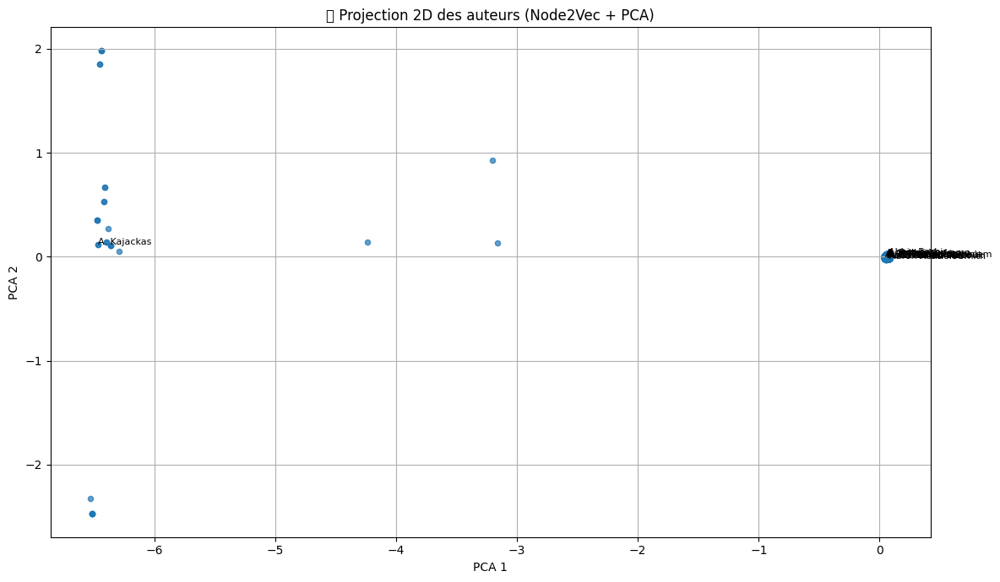

In [ ]:
import matplotlib.pyplot as plt

plt.figure(figsize=(12, 7))
plt.scatter(author_2d[:, 0], author_2d[:, 1], alpha=0.7, s=20)

# Optionnel : annoter quelques auteurs (les 15 premiers)
for i, name in enumerate(author_names[:15]):
    plt.text(author_2d[i, 0], author_2d[i, 1], name, fontsize=8)

plt.title("📍 Projection 2D des auteurs (Node2Vec + PCA)")
plt.xlabel("PCA 1")
plt.ylabel("PCA 2")
plt.grid(True)
plt.tight_layout()
plt.show()
